In [63]:
import numpy as np
#from autograd import grad
import matplotlib.pyplot as plt

#import tensorflow as tf
#import torch
np.set_printoptions(suppress=True)

import warnings
#suppress warnings
warnings.filterwarnings('ignore')

theta_list = []
checkpoint_list = []

year = [2016, 2017]

for year in year:
    
    # Import data
    if year == 2014:
        X = np.load('../data/processed/data_2014.npz')

    elif year == 2015:
        X = np.load('../data/processed/data_2015.npz')

    elif year == 2016:
        X = np.load('../data/processed/data_2016.npz')
        
    elif year == 2017:
        X = np.load('../data/processed/data_2017.npz')

    N = X['N']

    dist = X['distance']
    tI1 = X['tI1'].reshape(N,1)
    tI2 = X['tI2'].reshape(N,1)
    sI2 = X['sI2'].reshape(N,1)
    
    y_may = X['y_may'].reshape(N,1)
    y_jun = X['y_jun'].reshape(N,1)
    y_jul = X['y_jul'].reshape(N,1)

    n_may = X['n_may'].reshape(N,1)
    n_jun = X['n_jun'].reshape(N,1)
    n_jul = X['n_jul'].reshape(N,1)

    a_may = X['a_may'].reshape(N,1)
    a_jun = X['a_jun'].reshape(N,1)
    a_jul = X['a_jul'].reshape(N,1)

    w_may = X['wind_may']
    w_jun = X['wind_jun']
    w_jul = X['wind_jul']

    sI1_may = X['sI1_may'].reshape(N,1)
    sI1_jun = X['sI1_jun'].reshape(N,1)
    sI1_jul = X['sI1_jul'].reshape(N,1)

    s_may = X['s_may'].reshape(N,1)
    s_jun = X['s_jun'].reshape(N,1)
    s_jul = X['s_jul'].reshape(N,1)


    # Define the function eta() which takes input parameters theta and returns the log-odds of disease for each yard i in current time period
    def eta(theta):
            
        beta1, beta2, delta1, delta2, gamma1, gamma2, alpha1, alpha2, eta11, eta12, eta21, eta22 = theta
        
        auto_infection1 = beta1 + delta1 * (y_jun / n_jun) * np.exp(-eta11 * s_jun)
        auto_infection2 = beta2 + delta2 * (y_jun / n_jun) * np.exp(-eta12 * s_jun)
        
        dispersal_component1 = gamma1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun), axis=0, keepdims=True).T
        dispersal_component2 = gamma2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2), axis=0, keepdims=True).T
        
        eta = tI1 * (auto_infection1 + dispersal_component1) + tI2 * (auto_infection2 + dispersal_component2)
        
        return eta


    def costFunction(theta): 
        
        neg_log_likelihood = -(1/N) * np.sum(y_jul * eta(theta) - n_jul * np.log(1 + np.exp(eta(theta))))

        return neg_log_likelihood

    # Numerical gradient of the cost function
    #gradient = grad(costFunction)


    def partial(theta):
        
        beta1, beta2, delta1, delta2, gamma1, gamma2, alpha1, alpha2, eta11, eta12, eta21, eta22 = theta
        
        d_beta1 = tI1
        d_beta2 = tI2
        
        d_delta1 = tI1 * (y_jun / n_jun) * np.exp(-eta11 * s_jun)
        d_delta2 = tI2 * (y_jun / n_jun) * np.exp(-eta12 * s_jun)
        
        d_gamma1 = tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun), axis=0, keepdims=True).T
        d_gamma2 = tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2), axis=0, keepdims=True).T
        
        d_alpha1 = -gamma1 * tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun * dist.T), axis=0, keepdims=True).T
        d_alpha2 = -gamma2 * tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2 * dist.T), axis=0, keepdims=True).T
        
        d_eta11 = -tI1 * delta1 * s_jun * (y_jun / n_jun) * np.exp(-eta11 * s_jun)
        d_eta12 = -tI2 * delta2 * s_jun * (y_jun / n_jun) * np.exp(-eta12 * s_jun)

        d_eta21 = -gamma1 * tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun * s_jun), axis=0, keepdims=True).T
        d_eta22 = -gamma2 * tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2 * s_jun), axis=0, keepdims=True).T

        grad_entries = np.array([d_beta1, d_beta2, d_delta1, d_delta2, d_gamma1, d_gamma2, d_alpha1, d_alpha2, d_eta11, d_eta12, d_eta21, d_eta22])
        
        return grad_entries

    def partial_by_partial(theta):
        
        beta1, beta2, delta1, delta2, gamma1, gamma2, alpha1, alpha2, eta11, eta12, eta21, eta22 = theta
        
        d_beta1 = tI1
        d_beta2 = tI2
        
        d_delta1 = tI1 * (y_jun / n_jun) * np.exp(-eta11 * s_jun)
        d_delta2 = tI2 * (y_jun / n_jun) * np.exp(-eta12 * s_jun)
        
        d_gamma1 = tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun), axis=0, keepdims=True).T
        d_gamma2 = tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2), axis=0, keepdims=True).T
        
        d_alpha1 = -gamma1 * tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun * dist.T), axis=0, keepdims=True).T
        d_alpha2 = -gamma2 * tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2 * dist.T), axis=0, keepdims=True).T
        
        d_eta11 = -tI1 * delta1 * s_jun * (y_jun / n_jun) * np.exp(-eta11 * s_jun)
        d_eta12 = -tI2 * delta2 * s_jun * (y_jun / n_jun) * np.exp(-eta12 * s_jun)

        d_eta21 = -gamma1 * tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun * s_jun), axis=0, keepdims=True).T
        d_eta22 = -gamma2 * tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2 * s_jun), axis=0, keepdims=True).T

        grad_entries = np.array([[d_beta1*d_beta1, d_beta2*d_beta1, d_delta1*d_beta1, d_delta2*d_beta1, d_gamma1*d_beta1, d_gamma2*d_beta1, d_alpha1*d_beta1, d_alpha2*d_beta1, d_eta11*d_beta1, d_eta12*d_beta1, d_eta21*d_beta1, d_eta22*d_beta1],
                                [d_beta1*d_beta2, d_beta2*d_beta2, d_delta1*d_beta2, d_delta2*d_beta2, d_gamma1*d_beta2, d_gamma2*d_beta2, d_alpha1*d_beta2, d_alpha2*d_beta2, d_eta11*d_beta2, d_eta12*d_beta2, d_eta21*d_beta2, d_eta22*d_beta2],
                                [d_beta1*d_delta1, d_beta2*d_delta1, d_delta1*d_delta1, d_delta2*d_delta1, d_gamma1*d_delta1, d_gamma2*d_delta1, d_alpha1*d_delta1, d_alpha2*d_delta1, d_eta11*d_delta1, d_eta12*d_delta1, d_eta21*d_delta1, d_eta22*d_delta1],
                                [d_beta1*d_delta2, d_beta2*d_delta2, d_delta1*d_delta2, d_delta2*d_delta2, d_gamma1*d_delta2, d_gamma2*d_delta2, d_alpha1*d_delta2, d_alpha2*d_delta2, d_eta11*d_delta2, d_eta12*d_delta2, d_eta21*d_delta2, d_eta22*d_delta2],
                                [d_beta1*d_gamma1, d_beta2*d_gamma1, d_delta1*d_gamma1, d_delta2*d_gamma1, d_gamma1*d_gamma1, d_gamma2*d_gamma1, d_alpha1*d_gamma1, d_alpha2*d_gamma1, d_eta11*d_gamma1, d_eta12*d_gamma1, d_eta21*d_gamma1, d_eta22*d_gamma1],
                                [d_beta1*d_gamma2, d_beta2*d_gamma2, d_delta1*d_gamma2, d_delta2*d_gamma2, d_gamma1*d_gamma2, d_gamma2*d_gamma2, d_alpha1*d_gamma2, d_alpha2*d_gamma2, d_eta11*d_gamma2, d_eta12*d_gamma2, d_eta21*d_gamma2, d_eta22*d_gamma2],
                                [d_beta1*d_alpha1, d_beta2*d_alpha1, d_delta1*d_alpha1, d_delta2*d_alpha1, d_gamma1*d_alpha1, d_gamma2*d_alpha1, d_alpha1*d_alpha1, d_alpha2*d_alpha1, d_eta11*d_alpha1, d_eta12*d_alpha1, d_eta21*d_alpha1, d_eta22*d_alpha1],
                                [d_beta1*d_alpha2, d_beta2*d_alpha2, d_delta1*d_alpha2, d_delta2*d_alpha2, d_gamma1*d_alpha2, d_gamma2*d_alpha2, d_alpha1*d_alpha2, d_alpha2*d_alpha2, d_eta11*d_alpha2, d_eta12*d_alpha2, d_eta21*d_alpha2, d_eta22*d_alpha2],
                                [d_beta1*d_eta11, d_beta2*d_eta11, d_delta1*d_eta11, d_delta2*d_eta11, d_gamma1*d_eta11, d_gamma2*d_eta11, d_alpha1*d_eta11, d_alpha2*d_eta11, d_eta11*d_eta11, d_eta12*d_eta11, d_eta21*d_eta11, d_eta22*d_eta11],
                                [d_beta1*d_eta12, d_beta2*d_eta12, d_delta1*d_eta12, d_delta2*d_eta12, d_gamma1*d_eta12, d_gamma2*d_eta12, d_alpha1*d_eta12, d_alpha2*d_eta12, d_eta11*d_eta12, d_eta12*d_eta12, d_eta21*d_eta12, d_eta22*d_eta12],
                                [d_beta1*d_eta21, d_beta2*d_eta21, d_delta1*d_eta21, d_delta2*d_eta21, d_gamma1*d_eta21, d_gamma2*d_eta21, d_alpha1*d_eta21, d_alpha2*d_eta21, d_eta11*d_eta21, d_eta12*d_eta21, d_eta21*d_eta21, d_eta22*d_eta21],
                                [d_beta1*d_eta22, d_beta2*d_eta22, d_delta1*d_eta22, d_delta2*d_eta22, d_gamma1*d_eta22, d_gamma2*d_eta22, d_alpha1*d_eta22, d_alpha2*d_eta22, d_eta11*d_eta22, d_eta12*d_eta22, d_eta21*d_eta22, d_eta22*d_eta22]])
        
        
        
        return grad_entries

    def partial_sq(theta):
        
        beta1, beta2, delta1, delta2, gamma1, gamma2, alpha1, alpha2, eta11, eta12, eta21, eta22 = theta
        
        # delta1 second derivatives
        
        d_delta1_d_eta11 = -tI1 * (y_jun / n_jun) * np.exp(-eta11 * s_jun) * s_jun
        d_delta1_d_eta12 = 0
        
        d_delta2_d_eta11 = 0
        d_delta2_d_eta12 = -tI2 * (y_jun / n_jun) * np.exp(-eta12 * s_jun) * s_jun
        
        d_gamma1_d_eta21 = -tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun * s_jun), axis=0, keepdims=True).T
        d_gamma1_d_eta22 = 0
        d_gamma1_d_alpha1 = -tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun * dist.T), axis=0, keepdims=True).T
        d_gamma1_d_alpha2 = 0
        
        d_gamma2_d_eta21 = 0
        d_gamma2_d_eta22 = -tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2 * s_jun), axis=0, keepdims=True).T
        d_gamma2_d_alpha1 = 0
        d_gamma2_d_alpha2 = -tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2 * dist.T), axis=0, keepdims=True).T
        
        d_alpha1_d_gamma1 = -tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun * dist.T), axis=0, keepdims=True).T
        d_alpha1_d_gamma2 = 0
        d_alpha1_d_eta21 = gamma1 * tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun * dist.T * s_jun), axis=0, keepdims=True).T
        d_alpha1_d_eta22 = 0
        d_alpha1_d_alpha1 = gamma1 * tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun * (dist.T)**2), axis=0, keepdims=True).T
        d_alpha1_d_alpha2 = 0
        
        d_alpha2_d_gamma1 = 0
        d_alpha2_d_gamma2 = -tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2 * dist.T), axis=0, keepdims=True).T
        d_alpha2_d_eta21 = 0
        d_alpha2_d_eta22 = gamma2 * tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2 * dist.T * s_jun), axis=0, keepdims=True).T
        d_alpha2_d_alpha1 = 0
        d_alpha2_d_alpha2 = gamma2 * tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2 * (dist.T)**2), axis=0, keepdims=True).T
        
        d_eta11_d_delta1 = -tI1 * s_jun * (y_jun / n_jun) * np.exp(-eta11 * s_jun)
        d_eta11_d_delta2 = 0
        d_eta11_d_eta11 = tI1 * delta1 * (s_jun**2) * (y_jun / n_jun) * np.exp(-eta11 * s_jun)
        d_eta11_d_eta12 = 0
        
        d_eta12_d_delta1 = 0
        d_eta12_d_delta2 = -tI2 * s_jun * (y_jun / n_jun) * np.exp(-eta12 * s_jun)
        d_eta12_d_eta11 = 0
        d_eta12_d_eta12 = tI2 * delta2 * (s_jun**2) * (y_jun / n_jun) * np.exp(-eta12 * s_jun)
        
        d_eta21_d_gamma1 = -tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun * s_jun), axis=0, keepdims=True).T
        d_eta21_d_gamma2 = 0
        d_eta21_d_eta21 = gamma1 * tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun * (s_jun**2)), axis=0, keepdims=True).T
        d_eta21_d_eta22 = 0
        d_eta21_d_alpha1 = gamma1 * tI1 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta21 * s_jun) * (w_jun * np.exp(-alpha1 * dist)).T * sI1_jun * s_jun * (dist.T)), axis=0, keepdims=True).T
        d_eta21_d_alpha2 = 0
        
        d_eta22_d_gamma1 = 0
        d_eta22_d_gamma2 = -tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2 * s_jun), axis=0, keepdims=True).T
        d_eta22_d_eta21 = 0
        d_eta22_d_eta22 = gamma2 * tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2 * (s_jun**2)), axis=0, keepdims=True).T
        d_eta22_d_alpha1 = 0
        d_eta22_d_alpha2 = gamma2 * tI2 * np.sum(((a_jun * (y_jun / n_jun)) * np.exp(-eta22 * s_jun) * (w_jun * np.exp(-alpha2 * dist)).T * sI2 * s_jun * (dist.T)), axis=0, keepdims=True).T
        
        zero = np.zeros((N, 1))
        
        hess_entries = np.array([[zero, zero, zero, zero, zero, zero, zero, zero, zero, zero, zero, zero],    #d_beta1
                                [zero, zero, zero, zero, zero, zero, zero, zero, zero, zero, zero, zero],    #d_beta2
                                [zero, zero, zero, zero, zero, zero, zero, zero, d_eta11_d_delta1, zero, zero, zero],    #d_delta1
                                [zero, zero, zero, zero, zero, zero, zero, zero, zero, d_eta12_d_delta2, zero, zero],    #d_delta2
                                [zero, zero, zero, zero, zero, zero, d_alpha1_d_gamma1, zero, zero, zero, d_eta21_d_gamma1, zero],    #d_gamma1
                                [zero, zero, zero, zero, zero, zero, zero, d_alpha2_d_gamma2, zero, zero, zero, d_eta22_d_gamma2],    #d_gamma2
                                [zero, zero, zero, zero, d_gamma1_d_alpha1, zero, d_alpha1_d_alpha1, zero, zero, zero, d_eta21_d_alpha1, zero],    #d_alpha1
                                [zero, zero, zero, zero, zero, d_gamma2_d_alpha2, zero, d_alpha2_d_alpha2, zero, zero, zero, d_eta22_d_alpha2],    #d_alpha2
                                [zero, zero, d_delta1_d_eta11, zero, zero, zero, zero, zero, d_eta11_d_eta11, zero, zero, zero],    #d_eta11
                                [zero, zero, zero, d_delta2_d_eta12, zero, zero, zero, zero, zero, d_eta12_d_eta12, zero, zero],    #d_eta12
                                [zero, zero, zero, zero, d_gamma1_d_eta21, zero, d_alpha1_d_eta21, zero, zero, zero, d_eta21_d_eta21, zero],    #d_eta21
                                [zero, zero, zero, zero, zero, d_gamma2_d_eta22, zero, d_alpha2_d_eta22, zero, zero, zero, d_eta22_d_eta22]])   #d_eta22
        
        
        return hess_entries



    # Gradient entries
    def gradient(theta):
        
        mu = y_jul - (n_jul / (1 + np.exp(-eta(theta))))
        
        # Gradient 
        gradient = - (1 / N) * np.sum((partial(theta) * mu), axis=1)
        
        return gradient


    # Hessian
    def hessian(theta):
        
        mu = y_jul - (n_jul / (1 + np.exp(-eta(theta))))
        
        # Hessian entries
        hessian = - (1 / N) * np.sum((partial_sq(theta) * mu - n_jul * (partial_by_partial(theta)) * (np.exp(-eta(theta)) / (1 + np.exp(-eta(theta)))**2)), axis=2)
        hessian = hessian.reshape((12, 12))
        
        return hessian
    
    
    # Adam optimizer
    def adam(theta, alpha, num_iters, tolerance, b_1=0.9, b_2=0.999, eps=1e-8):

        # Make a copy of theta, to avoid changing the original array, since numpy arrays are passed by reference to functions
        theta = theta.copy()
        
        # Use a python list to save cost in every iteration
        J_history = []
        
        m = np.zeros(theta.shape)
        v = np.zeros(theta.shape)
        
        for i in range(num_iters):
            
            # Gradient
            g = gradient(theta)

            # First moment
            m = b_1 * m + (1 - b_1) * g

            # Second moment
            v = b_2 * v + (1 - b_2) * g**2

            # Bias correction for the first and second moments

            mhat = m / (1 - b_1**(i+1))

            vhat = v / (1 - b_2**(i+1))
            
            change = alpha * mhat / (np.sqrt(vhat) + eps)
            
            # Update parameter theta
            theta = theta - change
            
            # save the cost J in every iteration
            J_history.append(costFunction(theta))
            # report progress
            
            print('Year: ', year, '#', i , 'cost: ', costFunction(theta), 'MaxGrad: ', np.max(np.abs(gradient(theta))), end='\r')
            #print('#', i , 'cost: ', costFunction(theta), 'MaxGrad: ', np.max(np.abs(gradient(theta))), 'MinEig: ', np.min(np.linalg.eigh(hessian(theta), UPLO='L')[0]), end='\r')
            
            #if (np.max(np.abs(gradient(theta))) <= tolerance) & (np.min(np.linalg.eigh(hessian(theta), UPLO='L')[0]) > 0):
            #   break
            
            if (np.max(np.abs(gradient(theta))) <= tolerance):
               break
            
        return theta, J_history

        
    # Initialize fitting parameters

    # Xavier initialization for theta
    #theta = np.random.normal(0, 1 / np.sqrt(N), size=(12, 1))

    # Use below theta to continue from checkpoint
    #checkpoint = np.load('../reports/may_jun_2014.npy', allow_pickle=True)
    
    if year == 2014:
    
        alpha = 0.0001
        tolerance = 1e-5
        theta = np.load('../reports/parameter_estimates_jun_jul_2014.npy', allow_pickle=True)
    
    if year == 2015:
        
        alpha = 0.0001
        tolerance = 1e-2
        theta = np.load('../reports/parameter_estimates_jun_jul_2015.npy', allow_pickle=True)
    
    elif year == 2016:
    
        alpha = 0.05
        tolerance = 1e-2
        theta = np.random.normal(0, 1 / np.sqrt(N), size=(12, 1))
    
    elif year == 2017:
        
        alpha = 0.0005
        tolerance = 1e-5
        theta = np.random.normal(0, 1 / np.sqrt(N), size=(12, 1))
        
    #theta = np.load('../reports/theta2.npy')

    # Gradient descent settings
    iterations = 500000

    theta, J_history = adam(theta, alpha, iterations, tolerance)

    #print('iteration start:\t{:.3f}'.format(np.int32(checkpoint[1])))
    #print('previous final cost:\t{:.3f}'.format(checkpoint[2]))
    #print('updated final cost:\t{:.3f}'.format(J_history[-1]))
    #print('theta: \n', theta)

    #plt.plot(list(range(1, len(J_history) + 1)), J_history)
    #plt.xlabel('iterations')
    #plt.ylabel('cost')
    
    
    #plt.show()

    # Save trained parameters

    #iterations += checkpoint[1]
    checkpoint = np.array([theta, iterations, J_history], dtype=object)
    
    theta_list.append(theta)
    checkpoint_list.append(checkpoint)

    if year == 2014:
        
        np.save('../reports/parameter_estimates_jun_jul_2014.npy', theta)
        np.save('../reports/mle_checkpoint_2014.npy', checkpoint)
    
    elif year == 2015:
        
        np.save('../reports/parameter_estimates_jun_jul_2015.npy', theta)
        np.save('../reports/mle_checkpoint_2015.npy', checkpoint)
        
    elif year == 2016:
        
        np.save('../reports/parameter_estimates_jun_jul_2016.npy', theta)
        np.save('../reports/mle_checkpoint_2016.npy', checkpoint)
        
    elif year == 2017:
        
        np.save('../reports/parameter_estimates_jun_jul_2017.npy', theta)
        np.save('../reports/mle_checkpoint_2017.npy', checkpoint)
        
    
#np.save('../reports/parameter_estimates_jun_jul.npy', theta_list)
#np.save('../repo  rts/mle_checkpoint.npy', checkpoint_list)

## Function

$$
\eta_{i}=\sum_{k=1}^{K} I_{k}^{(t)}(i)\left[\beta_{k}+\delta_{k}\left(\frac{\tilde{y}_{i}}{n_{\tilde{y}_{i}}} \exp{\left(-\eta_{1k} s_{i}\right)}\right)+\gamma_{k} \sum_{j=1}^{M_{i}}\left(\frac{a_{j} z_{j}}{n_{z_{j}}} \exp{\left(-\eta_{2k} s_{j}\right)} w_{i j} \exp{\left(-\alpha_{k} d_{i j}\right)} I_{k}^{(s)}(j)\right)\right]
$$

## Derivatives

$$
\begin{align*}
\frac{\partial \eta_{i}}{\partial \beta_{k}} &= I_{k}^{(t)}(i) \\

\frac{\partial \eta_{i}}{\partial \delta_{k}} &= I_{k}^{(t)}(i)\left(\frac{\tilde{y}_{i}}{n_{\tilde{y}_{i}}}\right) \exp \left(-\eta_{1 k} s_{i}\right) \\

\frac{\partial \eta_{i}}{\partial \eta_{1 k}} &= -I_{k}^{(t)}(i) \delta_{k} s_{i}\left(\frac{\tilde{y}_{i}}{n_{\tilde{y}_{i}}}\right) \exp \left(-\eta_{1 k} s_{i}\right) \\

\frac{\partial \eta_{i}}{\partial \eta_{2 k}} &= -\gamma_{k} I_{k}^{(t)}(i) \sum_{j=1}^{M_{i}}\left[\left(\frac{a_{j} z_{j}}{n_{z j}}\right) \exp \left(-\eta_{2 k} s_{j}\right) w_{i j} \exp \left(-\alpha_{k} d_{i j}\right) I_{k}^{(s)}(j) s_{j}\right] \\

\frac{\partial \eta_{i}}{\partial \gamma_{k}} &= I_{k}^{(t)}(i) \sum_{j=1}^{M_{i}}\left[\left(\frac{a_{j} z_{j}}{n_{z_{j}}}\right) \exp \left(-\eta_{2 k} s_{j}\right) w_{i j} \exp \left(-\alpha_{k} d_{i j}\right) I_{k}^{(s)}(j)\right] \\

\frac{\partial \eta_{i}}{\partial \alpha_{k}} &= -\gamma_{k} I_{k}^{(t)}(i) \sum_{j=1}^{M_{i}}\left[\left(\frac{a_{j} z_{j}}{n_{z_{j}}}\right) \exp \left(-\eta_{2 k} s_{j}\right) w_{i j} \exp \left(-\alpha_{k} d_{i j}\right) I_{k}^{(s)}(j) d_{i j}\right]
\end{align*}
$$

### Cost Function

$$J(\theta) = 
-\frac{1}{N} \sum_{i=1}^{N} y_{i} \eta_{i}-n_{i} \log \left(1+e^{\eta_{i}}\right)
$$

### Gradient

$$\frac{\partial J}{\partial \theta} =
-\frac{1}{N}\sum_{i=1}^{N} \frac{\partial \eta_{i}}{\partial \theta}\left(y_{i}-\frac{n_{i}}{1+e^{-\eta_{i}}}\right)
$$


### Hessian

$$\frac{\partial^2 J}{\partial \theta^2} = -\frac{1}{N}
\sum_{i=1}^{N}\left[\frac{\partial^{2} \eta_{i}}{\partial \theta^{2}}\left(y_{i}-\frac{n_{i}}{1+e^{-\eta_{i}}}\right)- n_{i} \left(\frac{\partial \eta_{i}}{\partial \theta}\right)^{2}\frac{e^{-\eta_{i}}}{\left(1+e^{-\eta_{i}}\right)^2}\right]
$$

## Optimization

# 0 cost:  64.05423221509807 MaxGrad:  28.733742513212004 MinEig:  -223.48164215055027
# 1 cost:  63.97345121447362 MaxGrad:  28.699690876224082 MinEig:  -226.89062283828122
# 2 cost:  63.89376931116346 MaxGrad:  28.85472090561172 MinEig:  -230.36277704687274
# 3 cost:  63.81526653645637 MaxGrad:  29.07251915020175 MinEig:  -233.90137373901882
# 4 cost:  63.73801511535111 MaxGrad:  29.293103901648465 MinEig:  -237.5097385853668
# 5 cost:  63.66207595699565 MaxGrad:  29.51667672828909 MinEig:  -241.1912503009295
# 6 cost:  63.587494398042836 MaxGrad:  29.743435850194043 MinEig:  -244.9493380372863
# 7 cost:  63.514295178077546 MaxGrad:  29.973575991584376 MinEig:  -248.7874796562302
# 8 cost:  63.44247671923776 MaxGrad:  30.207288308680486 MinEig:  -252.7092007373201
# 9 cost:  63.37200493637434 MaxGrad:  30.444760378804116 MinEig:  -256.7180741945108
# 10 cost:  63.30280703188753 MaxGrad:  30.686176239013086 MinEig:  -260.81772039590504
# 11 cost:  63.23476602554361 MaxGrad:  30.931716

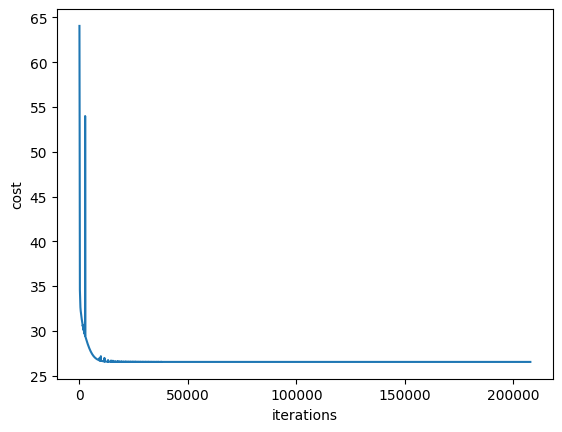

In [50]:
#checkpoint = np.array([theta, iterations, J_history], dtype=object)
#np.save('../reports/checkpoint_June_July2_backup.npy', checkpoint)

In [45]:
checkpoint = np.load('../reports/checkpoint_June_July2.npy', allow_pickle=True)
theta = checkpoint[0]

In [55]:
theta

array([[-1.4179313 ],
       [-6.50793259],
       [ 4.58200991],
       [ 2.07278098],
       [-0.00001509],
       [65.28367013],
       [-1.12455757],
       [ 1.96033951],
       [ 0.17642054],
       [20.11287342],
       [ 0.69716035],
       [ 0.00649973]])

## Parameter Estimation

## Function

$$
\eta_{i}=\sum_{k=1}^{K} I_{k}^{(t)}(i)\left[\beta_{k}+\delta_{k}\left(\frac{\tilde{y}_{i}}{n_{\tilde{y}_{i}}} \exp{\left(-\eta_{1k} s_{i}\right)}\right)+\gamma_{k} \sum_{j=1}^{M_{i}}\left(\frac{a_{j} z_{j}}{n_{z_{j}}} \exp{\left(-\eta_{2k} s_{j}\right)} w_{i j} \exp{\left(-\alpha_{k} d_{i j}\right)} I_{k}^{(s)}(j)\right)\right]
$$

$$\beta_1 = -2.89902093$$
$$\beta_2 = -4.33376942$$
$$\delta_1 = 3.86406603$$
$$\delta_2 = 7.1830044$$
$$\gamma_1 = 0.06209235$$
$$\gamma_2 = 6.21221296$$
$$\alpha_1 = 0.17578305$$
$$\alpha_2 = 1.31264131$$
$$\eta_{11} = 0.13978209$$
$$\eta_{12} = 0.40521989$$
$$\eta_{21} = -0.79182359$$
$$\eta_{22} = 0.55742334$$

## Eigenvalues of Hessian

In [56]:
np.linalg.eigvalsh(hessian(theta))

LinAlgError: Eigenvalues did not converge

## Gradient

In [57]:
gradient(theta)

array([[    0.18778924],
       [    0.        ],
       [    0.03459181],
       [    0.        ],
       [10252.57330378],
       [    0.        ],
       [    2.2678016 ],
       [   -0.        ],
       [   -0.381169  ],
       [   -0.        ],
       [    0.27055431],
       [   -0.        ]])

In [31]:
nGrad = nd.Gradient(costFunction)
nHess = nd.Hessian(costFunction)
hess_theta = nHess(theta.reshape(12,))
grad_theta = nGrad(theta.reshape(12,))

In [10]:
def prob(theta):
    
    p = 1 / (1 + np.exp(-eta(theta)))
    
    return p

In [12]:
print('estimated probability of disease: \n', prob(theta))

estimated probability of disease: 
 [[0.02611759]
 [0.02631787]
 [0.02620498]
 [0.03368977]
 [0.02623533]
 [0.02624147]
 [0.02745905]
 [0.02710209]
 [0.04514933]
 [0.04289552]
 [0.16258389]
 [0.03171659]
 [0.15754236]
 [0.03329544]
 [0.02628519]
 [0.02748307]
 [0.02906667]
 [0.02786479]
 [0.02657169]
 [0.02892042]
 [0.02622809]
 [0.04582204]
 [0.5       ]
 [0.84480418]
 [0.24196183]
 [0.2553849 ]
 [0.33620011]
 [0.02684969]
 [0.49306239]
 [0.80226981]
 [0.53574716]
 [0.41690551]
 [0.91858263]
 [0.14165495]
 [0.        ]
 [0.02439342]
 [0.02535986]
 [0.02457473]
 [0.02567178]
 [0.17610494]
 [0.02407955]
 [0.01639678]
 [0.01495841]
 [0.02234735]
 [0.02345555]
 [0.02276539]
 [0.5       ]
 [0.02272612]
 [0.02457618]
 [0.11173597]
 [0.10794024]
 [0.22234288]
 [0.14008519]
 [0.2470191 ]
 [0.24700966]
 [0.02734554]
 [0.25025533]
 [0.02731197]
 [0.2534015 ]
 [0.02732704]
 [0.24922973]
 [0.02735182]
 [0.02728799]
 [0.02733912]
 [0.02321656]
 [0.02306974]
 [0.02242573]
 [0.5       ]
 [0.02569351

In [13]:
prob(theta).shape

(104, 1)